In [11]:
import cv2
import pytesseract
from pytesseract import Output
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram
from sklearn.datasets import load_iris
from sklearn.cluster import AgglomerativeClustering

import scipy.cluster.hierarchy as shc

from imutils.object_detection import non_max_suppression
import numpy as np
import argparse
import time
import cv2

import cv2
import numpy as np
import cv2
import imutils
import numpy as np
import random
from matplotlib import pyplot as plt
from pdf2image import convert_from_path
import os
import tempfile
from pdf2image import convert_from_path
from PyPDF3 import PdfFileWriter, PdfFileReader
import glob
import cv2
import numpy as np
import PIL
from PIL import Image

pytesseract.pytesseract.tesseract_cmd = r"C:\Program Files\Tesseract-OCR\tesseract.exe"


In [12]:
def grouper(iterable, interval):
    prev = None
    group = []
    for item in iterable:
        if not prev or abs(item[1] - prev[1]) <= interval:
            group.append(item)
        else:
            yield group
            group = [item]
        prev = item
    if group:
        yield group

In [13]:
path=r"D:\College\FinalYearCapstone\StandardResume\coordinates"
pdf_image_list = [_ for _ in os.listdir(path) if _.endswith(".jpg")]

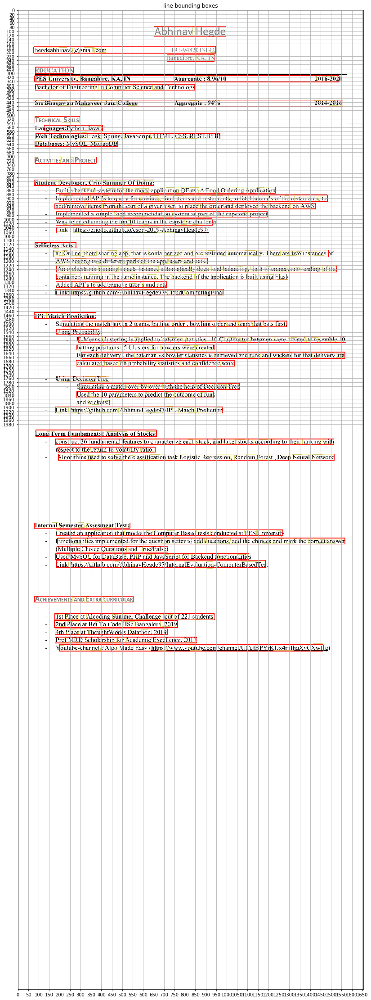

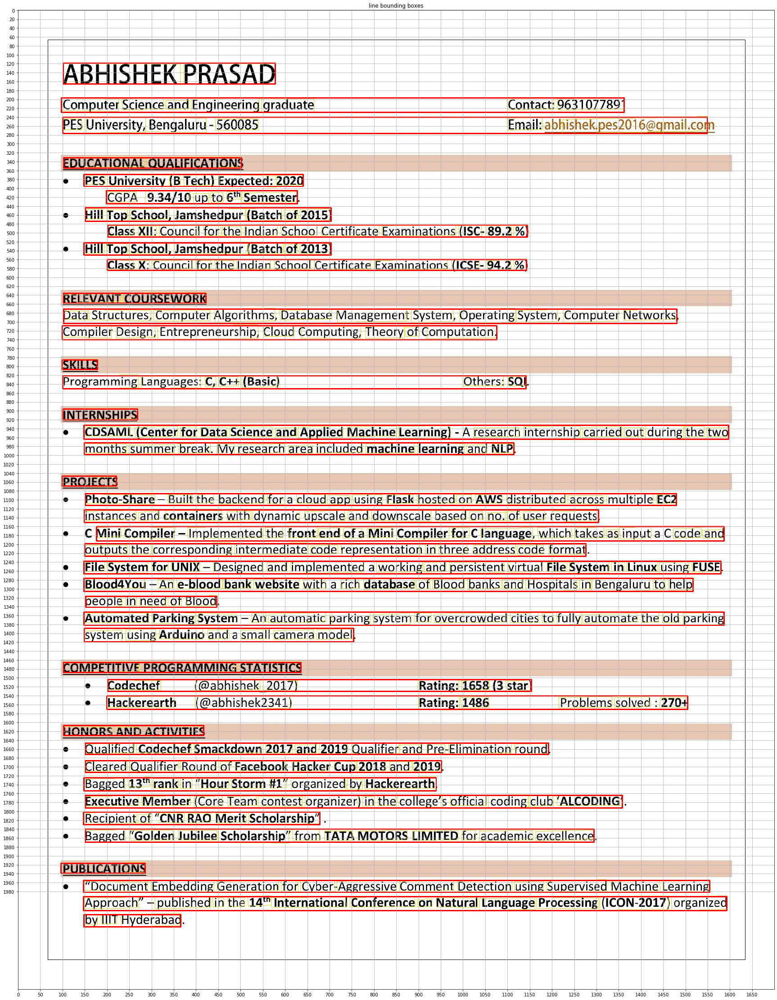

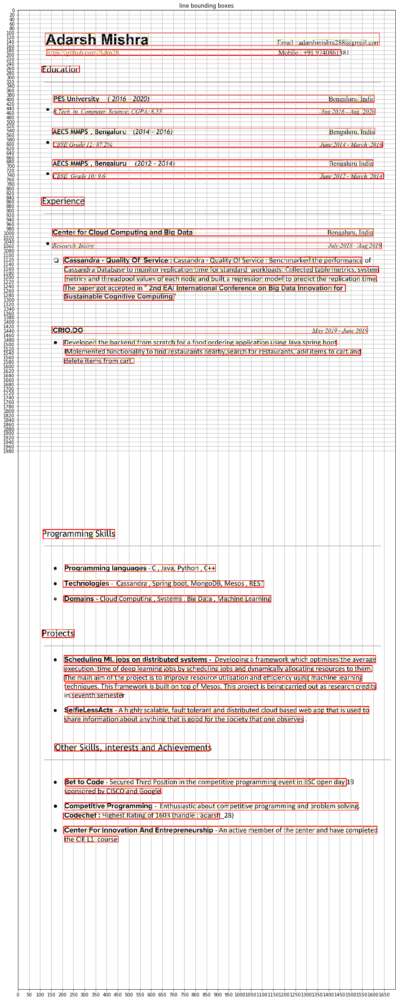

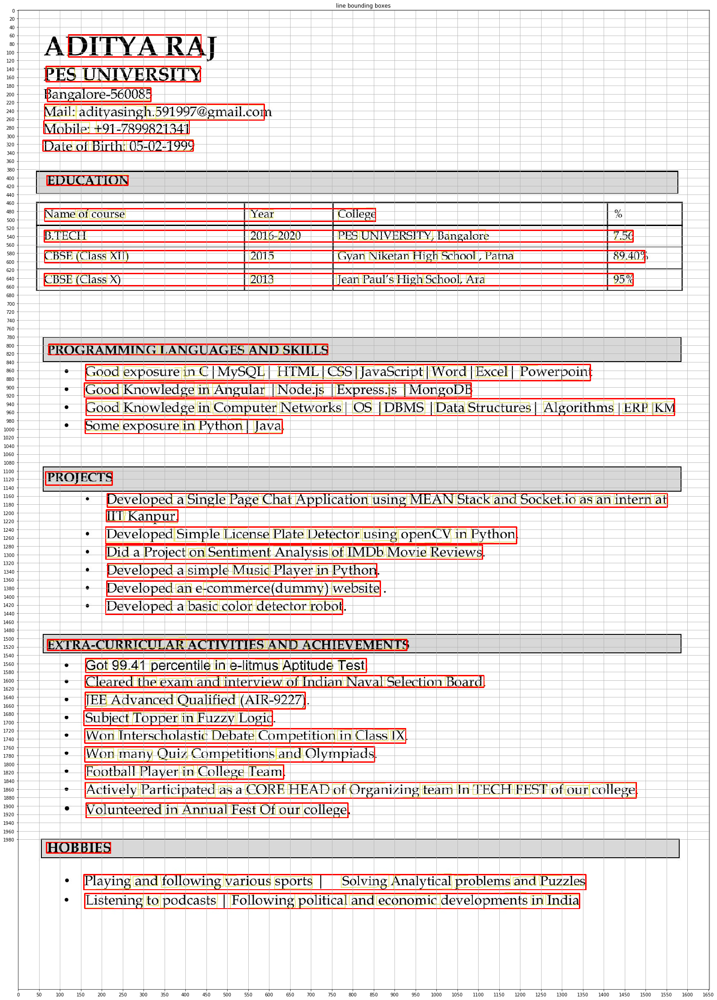

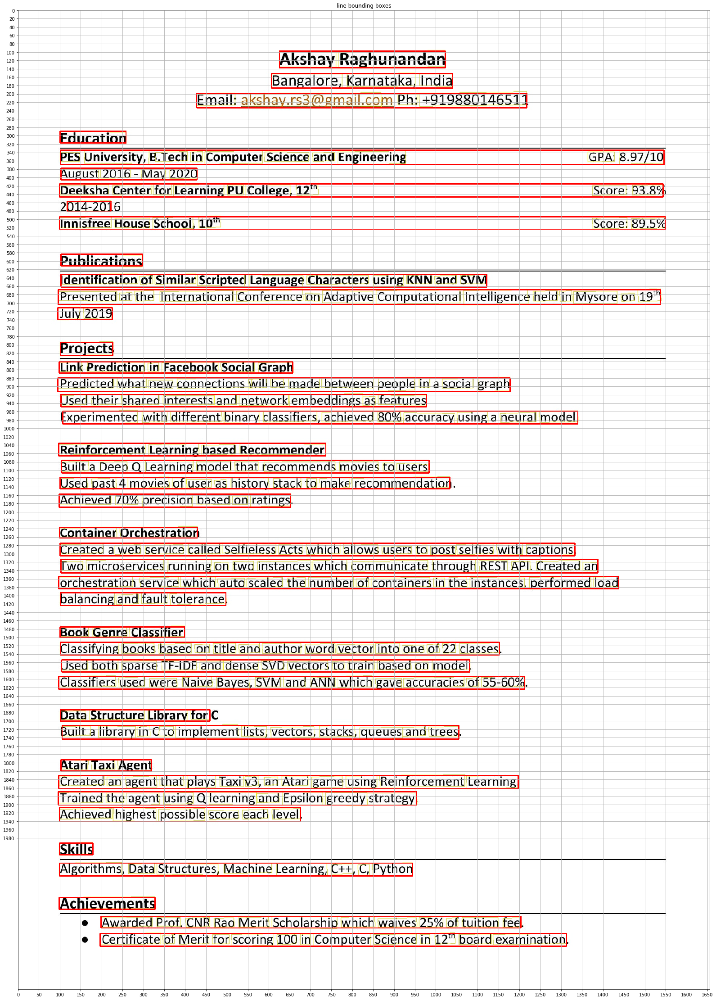

...

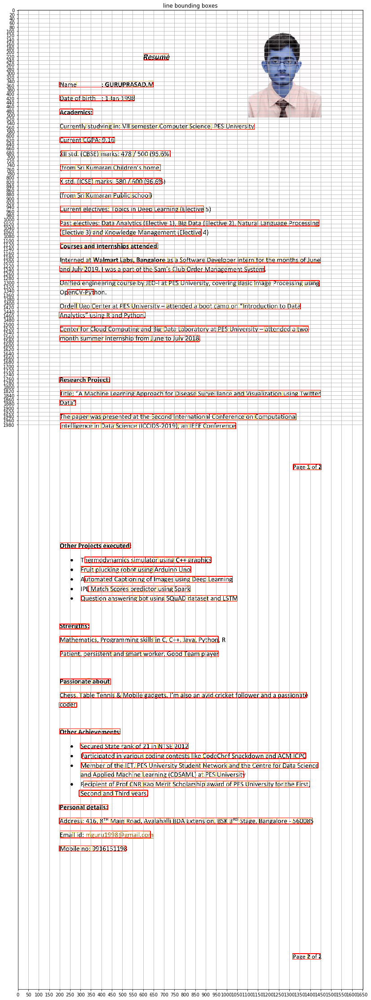

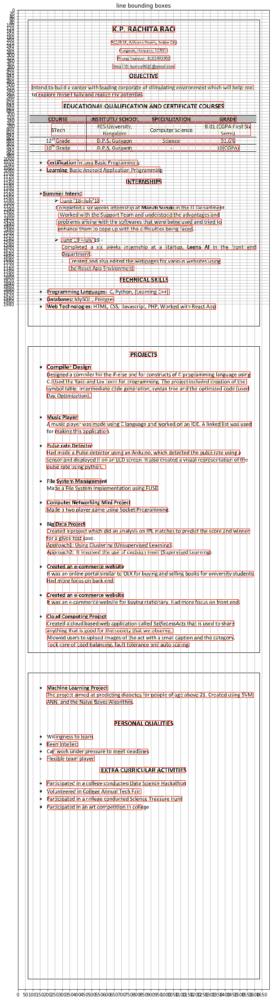

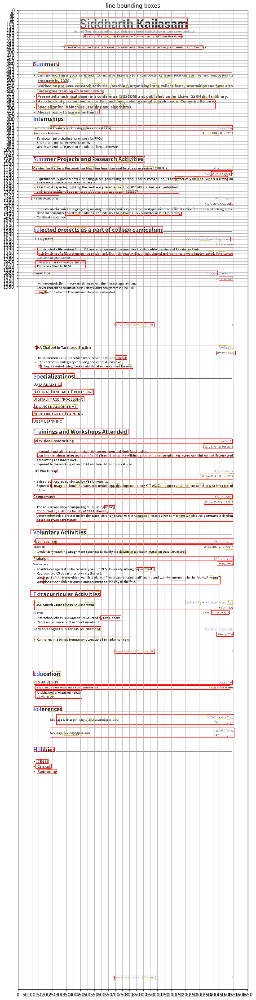

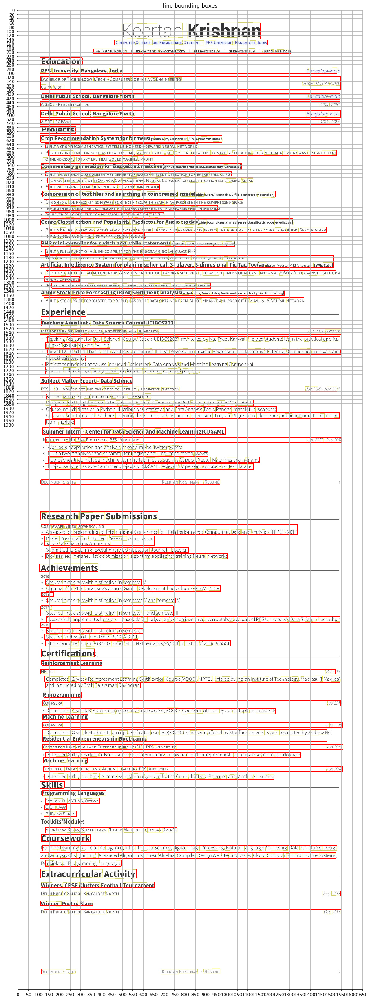

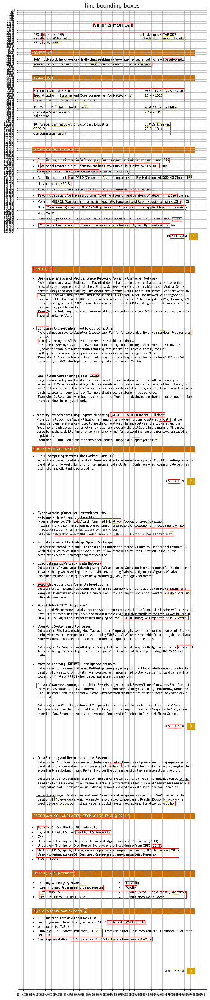

In [16]:
image_list = []
for pdf_image in pdf_image_list:
    pdf_image_name = path+'\\'+pdf_image
    pdf_text = pdf_image.replace('.jpg','.txt')
    pdf_txt_name = path+'\\'+pdf_text
    text_file = open(pdf_txt_name, "r")
    lines = text_file.readlines()
    text_file.close()
    img = cv2.imread( pdf_image_name)
    vals =[]
    for line in lines:
        coords = line.split(",")
        coords[-1]=coords[-1].rstrip('\n')
        if line=='\n':
            continue
        coords = list(map(int, coords)) 
        vals.append(coords)

    for val in vals:
        #get width |x1-x2| and height |y1-y4|
        width = abs(val[0]-val[2])
        height = abs(val[1]-val[7])
        #print(height, width)
        val.append(width)
        val.append(height)
    #print(vals)

    #getting only top lft coordinate and width, height
    bboxes = []
    for bbox in vals:
        x = [bbox[i] for i in [0,1,8,9]]
        bboxes.append(x)
    #print(bboxes)

    bboxes_list = list()
    heights = list()
    height_tot = 0
    for bbox in bboxes:
        x, y, w, h = bbox
        bboxes_list.append([x, y, x + w, y + h])  # list of bounding boxes with left-top and right-bottom coordinates
        heights.append(h)
        height_tot+=h
    heights = sorted(heights) 
    mean_height = height_tot/len(bboxes)
    #print(mean_height)

    bboxes_list1 = sorted(bboxes_list, key=lambda k: k[1])  # Sort the bounding boxes based on y1 coordinate ( y of the left-top coordinate )
    #print(bboxes_list1)
    combined_bboxes = grouper(bboxes_list1, mean_height)  # Group the bounding boxes
    #combined_bboxes
    line_box = []
    for group in combined_bboxes:
        x_min = min(group, key=lambda k: k[0])[0]  # Find min of x1
        x_max = max(group, key=lambda k: k[2])[2]  # Find max of x2
        y_min = min(group, key=lambda k: k[1])[1]  # Find min of y1
        y_max = max(group, key=lambda k: k[3])[3]  # Find max of y2
        temp = [x_min,y_min,x_max,y_max]
        line_box.append(temp)
        cv2.rectangle(img, (x_min, y_min), (x_max, y_max), (255, 0, 0), 2)

    image_list.append(img)
    fig= plt.figure(figsize=(60,40))
    ax = fig.gca()
    ax.set_xticks(np.arange(0, 1800, 50))
    ax.set_yticks(np.arange(0, 2000, 20))
    plt.imshow(img)
    plt.title('line bounding boxes')
    plt.grid()
    plt.show()

In [ ]:
#heuristic rules

In [17]:
image_list1 = [Image.fromarray(i) for i in image_list]
imagelist = image_list1[1:]
image_list1[0].save(r'ResultsStandResumeHeuristicLines.pdf',save_all=True, append_images=imagelist)